image size =  (711, 701)


Dispalying colour image of the scene


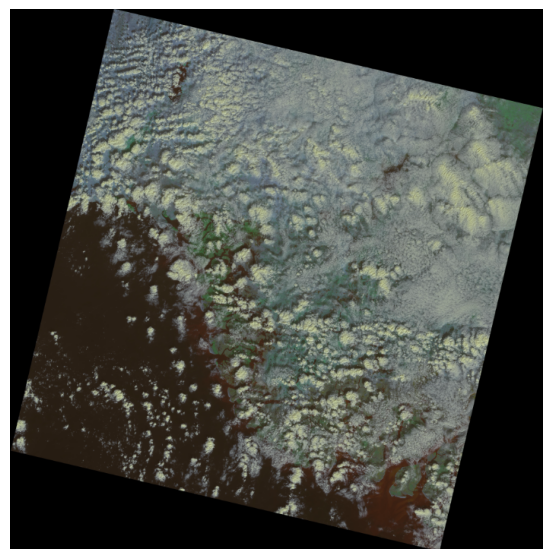

In [65]:
from IPython.display import Image, display
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import cv2
import matplotlib.pyplot as plt
import matplotlib.gridspec as grid
import numpy as np

# Read RGB image into an array
img = cv2.imread('images/image.png')
img_shape = img.shape[:2]
print('image size = ',img_shape)

# specify no of bands in the image
n_bands = 7

# 3 dimensional dummy array with zeros
MB_img = np.zeros((img_shape[0],img_shape[1],n_bands))

# stacking up images into the array
for i in range(n_bands):
    MB_img[:,:,i] = cv2.imread('images/image'+str(i+1)+'.png',
                               cv2.IMREAD_GRAYSCALE)  

# Let's take a look at scene
print('\n\nDispalying colour image of the scene')
plt.figure(figsize=(img_shape[0]/100,img_shape[1]/100))
plt.imshow(img, vmin=0, vmax=255)
plt.axis('off');

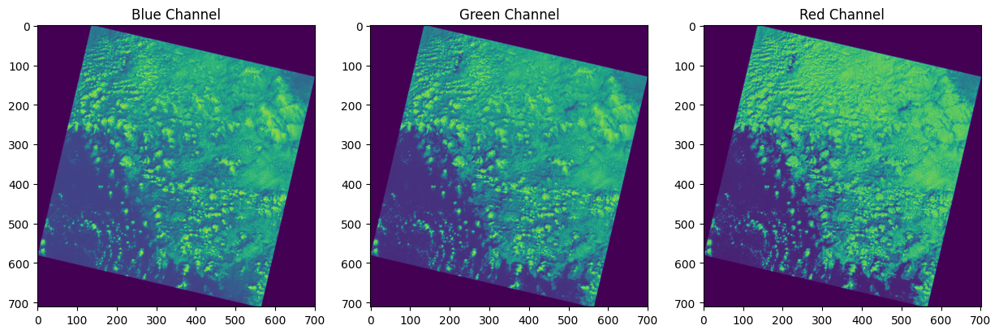

In [66]:
#Splitting into channels
blue,green,red = cv2.split(img)
# Plotting the images
fig = plt.figure(figsize = (15, 7.2)) 
fig.add_subplot(131)
plt.title("Blue Channel")
plt.imshow(blue)
fig.add_subplot(132)
plt.title("Green Channel")
plt.imshow(green)
fig.add_subplot(133)
plt.title("Red Channel")
plt.imshow(red)
plt.show()

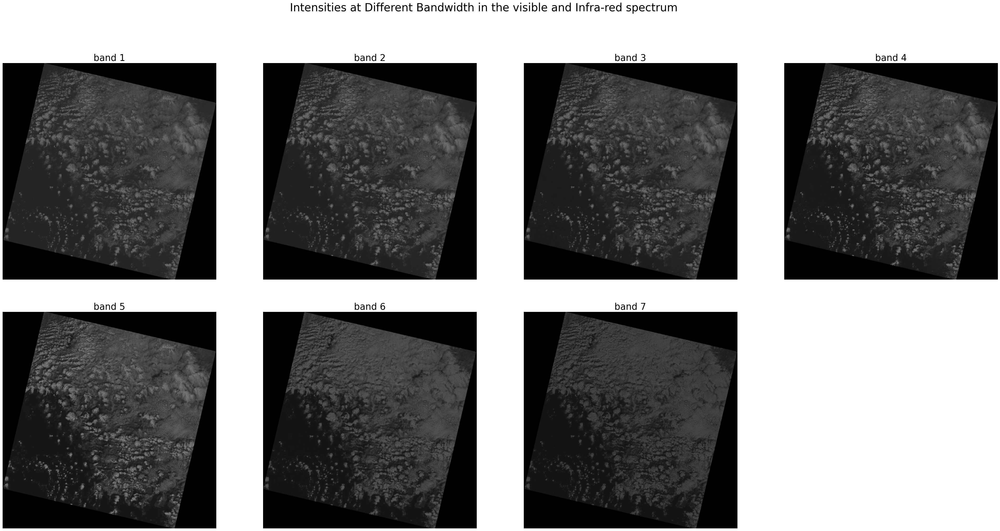

In [55]:
fig,axes = plt.subplots(2,4,figsize=(50,23),sharex='all', sharey='all')
fig.subplots_adjust(wspace=0.1, hspace=0.15)
fig.suptitle('Intensities at Different Bandwidth in the visible and Infra-red spectrum', fontsize=30)
axes = axes.ravel()

for i in range(n_bands):
    axes[i].imshow(MB_img[:,:,i],cmap='gray', vmin=0, vmax=255)
    axes[i].set_title('band '+str(i+1),fontsize=25)
    axes[i].axis('off')
fig.delaxes(axes[-1])

In [56]:
# Convert 2d band array in 1-d to make them as feature vectors and Standardization
MB_matrix = np.zeros((MB_img[:,:,0].size,n_bands))

for i in range(n_bands):
    MB_array = MB_img[:,:,i].flatten()  # covert 2d to 1d array 
    MB_arrayStd = (MB_array - MB_array.mean())/MB_array.std()  
    MB_matrix[:,i] = MB_arrayStd
MB_matrix.shape;

In [57]:
# Covariance
np.set_printoptions(precision=3)
cov = np.cov(MB_matrix.transpose())

# Eigen Values
EigVal,EigVec = np.linalg.eig(cov)

print("Eigenvalues:\n\n", EigVal,"\n")

Eigenvalues:

 [6.708e+00 1.375e-01 1.064e-01 2.428e-03 4.334e-03 1.809e-02 2.345e-02] 



In [58]:
# Ordering Eigen values and vectors
order = EigVal.argsort()[::-1]
EigVal = EigVal[order]
EigVec = EigVec[:,order]

#Projecting data on Eigen vector directions resulting to Principal Components 
PC = np.matmul(MB_matrix,EigVec)   #cross product
PC

array([[ 1.896,  0.638, -1.294, ..., -1.307,  0.622, -0.27 ],
       [ 3.264,  0.033,  0.114, ..., -0.036,  0.028, -0.004],
       [ 3.264,  0.033,  0.114, ..., -0.036,  0.028, -0.004],
       ...,
       [ 3.264,  0.033,  0.114, ..., -0.036,  0.028, -0.004],
       [ 3.264,  0.033,  0.114, ..., -0.036,  0.028, -0.004],
       [ 3.264,  0.033,  0.114, ..., -0.036,  0.028, -0.004]])

Text(0.5, 0.98, 'Pair plot of Band images')

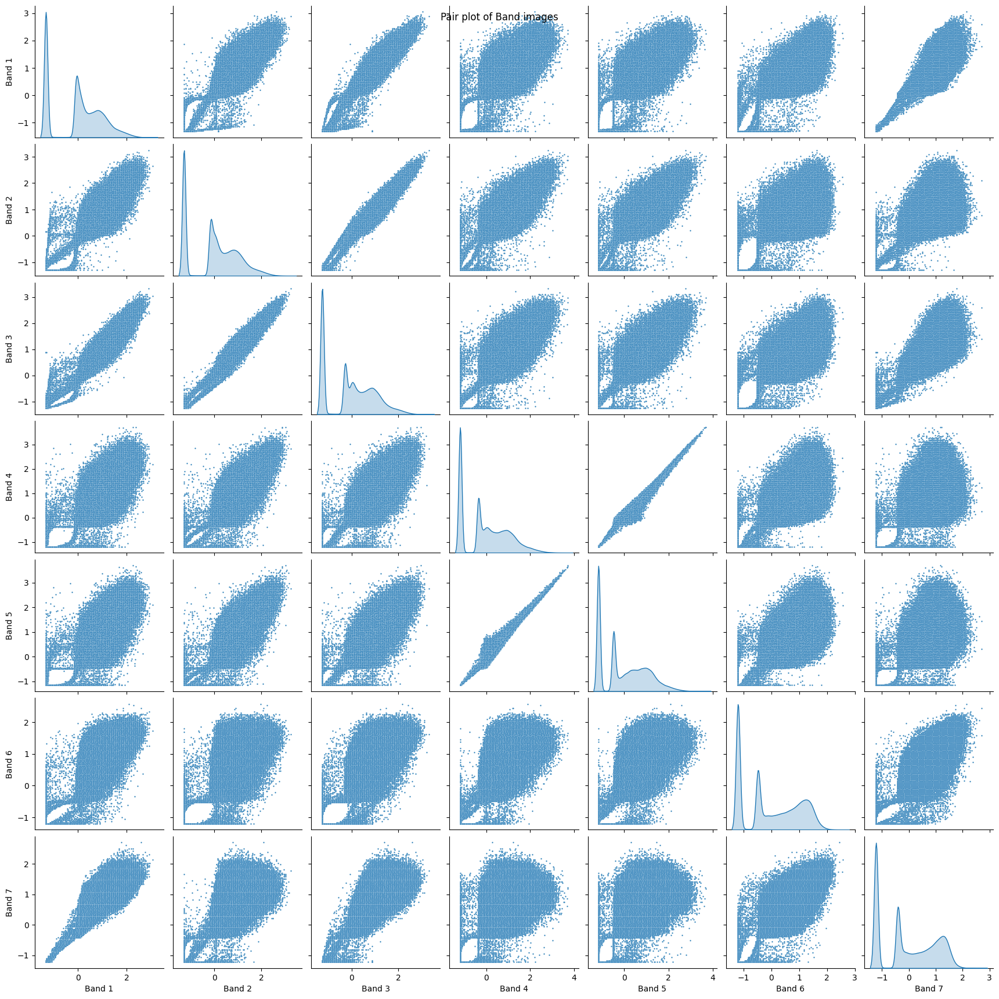

In [59]:
# Generate Paiplot for original data and transformed PCs

Bandnames = ['Band 1','Band 2','Band 3','Band 4','Band 5','Band 6','Band 7']
a = sns.pairplot(pd.DataFrame(MB_matrix,
                columns = Bandnames),
                 diag_kind='kde',plot_kws={"s": 3})
a.fig.suptitle("Pair plot of Band images")

Text(0.5, 0.98, 'Pair plot of PCs')

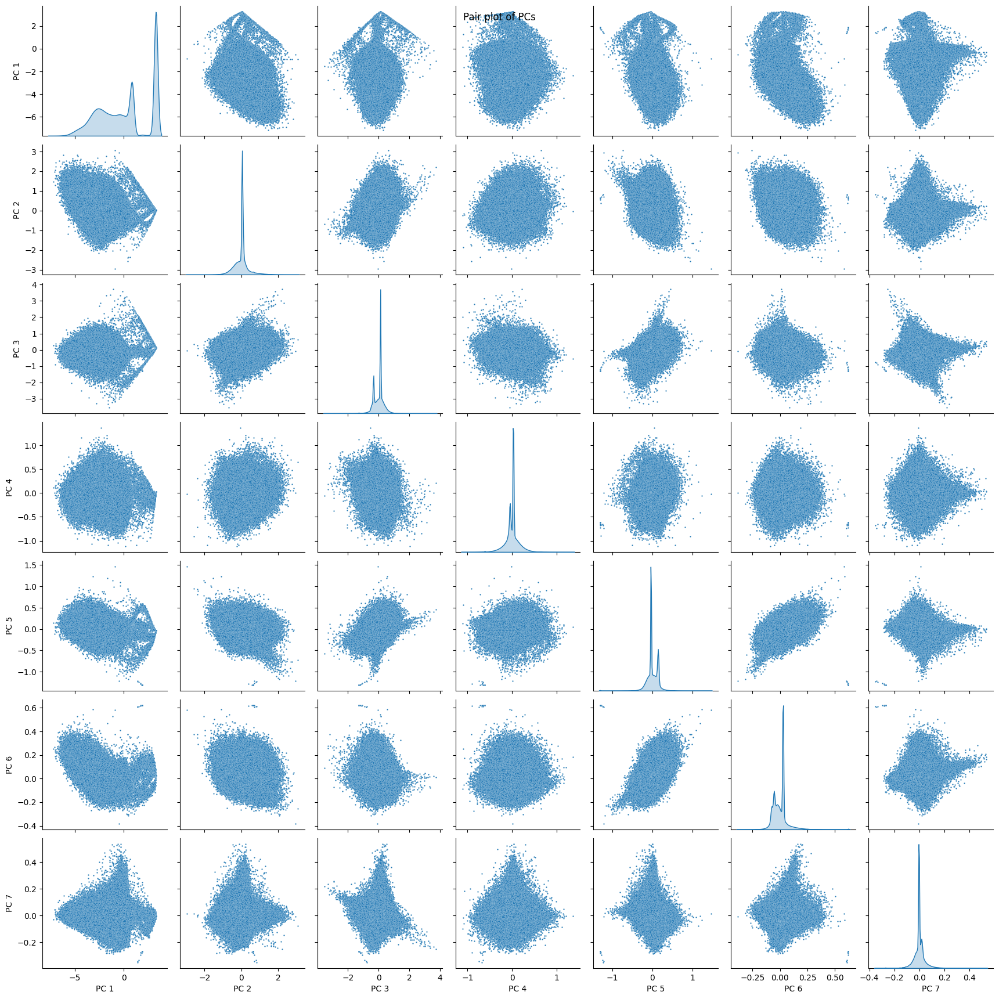

In [60]:
PCnames = ['PC 1','PC 2','PC 3','PC 4','PC 5','PC 6','PC 7']
b = sns.pairplot(pd.DataFrame(PC,
                columns = PCnames),
                 diag_kind='kde',plot_kws={"s": 3})
b.fig.suptitle("Pair plot of PCs")

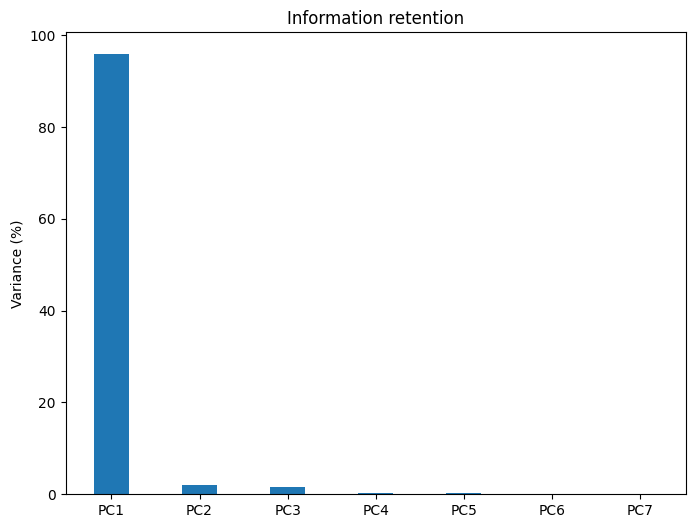

In [61]:
#Information Retained by Principal Components

plt.figure(figsize=(8,6))
plt.bar([1,2,3,4,5,6,7],EigVal/sum(EigVal)*100,align='center',width=0.4,
        tick_label = ['PC1','PC2','PC3','PC4','PC5','PC6','PC7'])
plt.ylabel('Variance (%)')
plt.title('Information retention');

In [62]:
# Rearranging 1-d arrays to 2-d arrays of image size

PC_2d = np.zeros((img_shape[0],img_shape[1],n_bands))
for i in range(n_bands):
    PC_2d[:,:,i] = PC[:,i].reshape(-1,img_shape[1])

# normalizing between 0 to 255
PC_2d_Norm = np.zeros((img_shape[0],img_shape[1],n_bands))
for i in range(n_bands):
    PC_2d_Norm[:,:,i] = cv2.normalize(PC_2d[:,:,i],
                    np.zeros(img_shape),0,255 ,cv2.NORM_MINMAX)

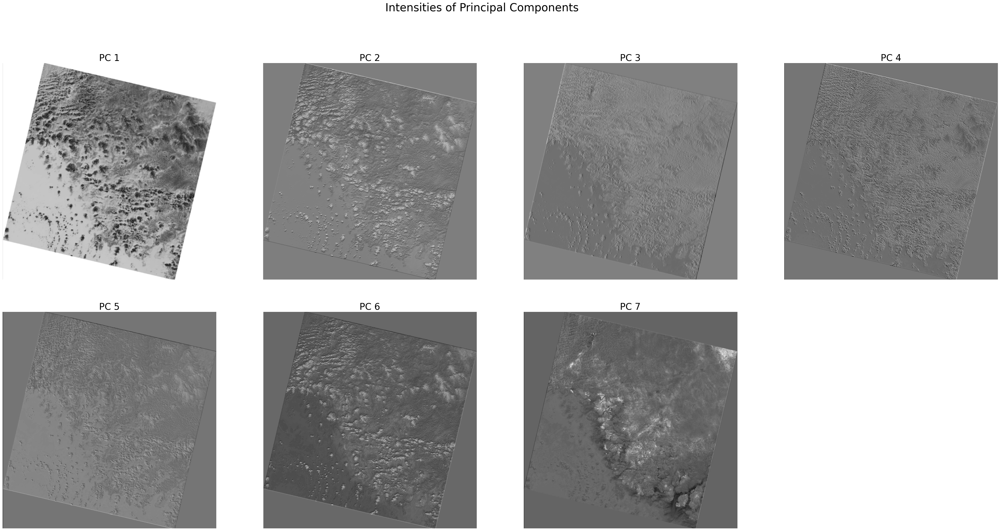

In [63]:

fig,axes = plt.subplots(2,4,figsize=(50,23),sharex='all',
                        sharey='all')
fig.subplots_adjust(wspace=0.1, hspace=0.15)
fig.suptitle('Intensities of Principal Components ', fontsize=30)

axes = axes.ravel()
for i in range(n_bands):
    axes[i].imshow(PC_2d_Norm[:,:,i],cmap='gray', vmin=0, vmax=255)
    axes[i].set_title('PC '+str(i+1),fontsize=25)
    axes[i].axis('off')
fig.delaxes(axes[-1])

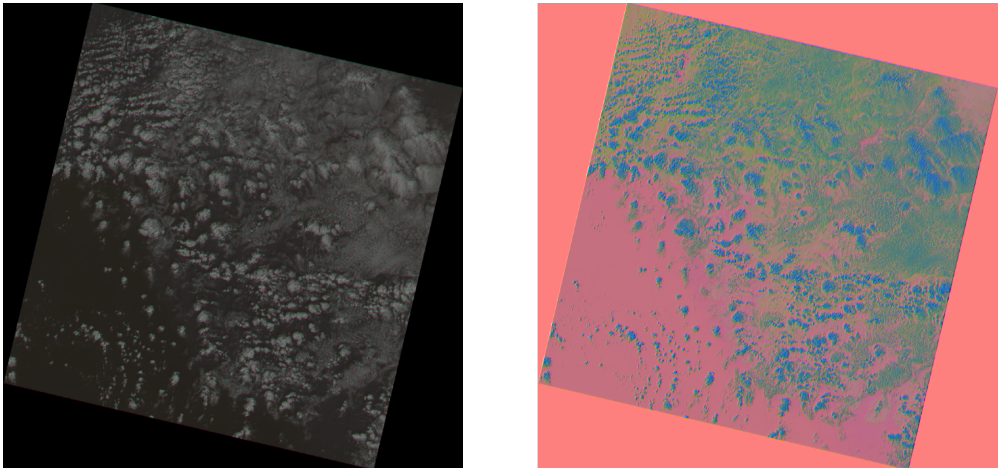

In [64]:
# Comparsion of RGB and Image produced using first three bands
fig,axes = plt.subplots(1,2,figsize=(50,23),
                        sharex='all', sharey='all')   
fig.subplots_adjust(wspace=0.1, hspace=0.15)

axes[0].imshow(MB_img[:,:,0:3].astype(int))
axes[0].axis('off');

axes[1].imshow(PC_2d_Norm[:,:,:3][:,:,[0,2,1]].astype(int))
axes[1].axis('off');